# EDA

In [241]:
import os # Utilidades de rutas en el sistema operativo
import matplotlib.pyplot as plt # Utilidades de gráficos generales
import seaborn as sns # Gráficos estadísticos avanzados

import pandas as pd
import numpy as np
#from dotenv import load_dotenv # Obtención de variables de ambiente desde archivo .env
#load_dotenv(override=True)

from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.preprocessing import MinMaxScaler, OrdinalEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score,mean_squared_error,r2_score, mean_absolute_error
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

# comando para poder desplegar totalmente los dataframes y poderlos visualizar
# completamente
pd.set_option("display.max_rows", None, "display.max_columns", None)

### Lectura de datos de entrenamiento y validación

In [208]:
ruta_datos_entrenamiento = "./base_train.csv"
ruta_datos_validacion = "./base_validacion.csv"
datos_entrenamiento = pd.read_csv(ruta_datos_entrenamiento, sep = "|")
datos_validacion = pd.read_csv(ruta_datos_validacion, sep = "|")

In [106]:
datos_entrenamiento.describe()

,num_doc,f_analisis,default,trx39,trx102,trx106,trx143,trx158,disp309,CO01END010RO,...,CO01END086RO,CO01END094RO,CO02NUM086AH,CO02NUM043RO,CO01EXP002AH,CO01NUM002AH,CO01END051RO,CO01ACP011RO,CO02MOR092TO,CO01MOR098RO
count,2.827600e+04,28276.000000,28276.000000,28276.000000,28276.000000,28276.000000,28276.000000,28276.000000,28276.000000,28276.000000,...,28276.000000,28276.000000,28276.000000,28276.000000,28276.000000,28276.000000,28276.000000,28276.000000,28276.000000,28276.000000
mean,4.974533e+11,201808.536285,0.067372,0.675212,0.009988,0.009386,0.157412,0.106482,6.727401,1.714396,...,36.270536,6.353860,44.648904,35.537686,8.179233,2.629898,5.007108,0.180259,72.962840,48.529336
std,2.875796e+11,3.231793,0.250669,1.003746,0.070848,0.068895,0.284814,0.225333,3.952865,4.576126,...,39.832468,13.412629,23.386687,35.573957,13.073666,1.239205,17.239716,2.223357,42.869349,48.958556
min,5.257814e+07,201801.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-3.000000,...,-4.000000,-4.000000,-3.000000,-1.000000,-1.000000,-1.000000,-4.000000,-3.000000,-3.000000,-3.000000
25%,2.500376e+11,201806.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,-1.000000,...,-1.000000,-1.000000,28.570000,0.000000,2.000000,2.000000,-1.000000,-1.000000,47.346860,-1.000000
50%,4.949118e+11,201810.000000,0.000000,0.276385,0.000000,0.000000,0.014986,0.008533,7.000000,0.490000,...,25.670000,2.560000,40.000000,33.330000,6.000000,2.000000,0.700000,0.000000,100.000000,55.881760
75%,7.456302e+11,201811.000000,0.000000,0.953794,0.000006,0.000005,0.185602,0.103468,10.000000,2.700000,...,68.532500,7.680000,57.140000,66.670000,12.000000,3.000000,4.410000,1.000000,100.000000,100.000000
max,9.999384e+11,201812.000000,1.000000,13.231644,2.688028,2.688028,3.755929,3.038751,12.000000,90.030000,...,1276.110000,512.010000,100.000000,100.000000,673.000000,13.000000,872.320000,59.000000,100.000000,100.000000


In [6]:
datos_entrenamiento.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28276 entries, 0 to 28275
Data columns (total 28 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   num_doc       28276 non-null  float64
 1   f_analisis    28276 non-null  int64  
 2   default       28276 non-null  int64  
 3   tipo_cliente  28276 non-null  object 
 4   trx39         28276 non-null  float64
 5   trx102        28276 non-null  float64
 6   trx106        28276 non-null  float64
 7   trx143        28276 non-null  float64
 8   trx158        28276 non-null  float64
 9   disp309       28276 non-null  float64
 10  CO01END010RO  28276 non-null  float64
 11  CO01ACP017CC  28276 non-null  float64
 12  CO02EXP011TO  28276 non-null  float64
 13  CO02EXP004TO  28276 non-null  float64
 14  CO01EXP001CC  28276 non-null  float64
 15  CO01EXP003RO  28276 non-null  float64
 16  CO02END015CC  28276 non-null  float64
 17  CO01END002RO  28276 non-null  float64
 18  CO01END086RO  28276 non-nu

De la anterior información, podemos ver que nuestro dataset No contienen valores nulos.

C:\Users\AESPINA\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
C:\Users\AESPINA\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
C:\Users\AESPINA\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_base.py:949: FutureWarning: When gro

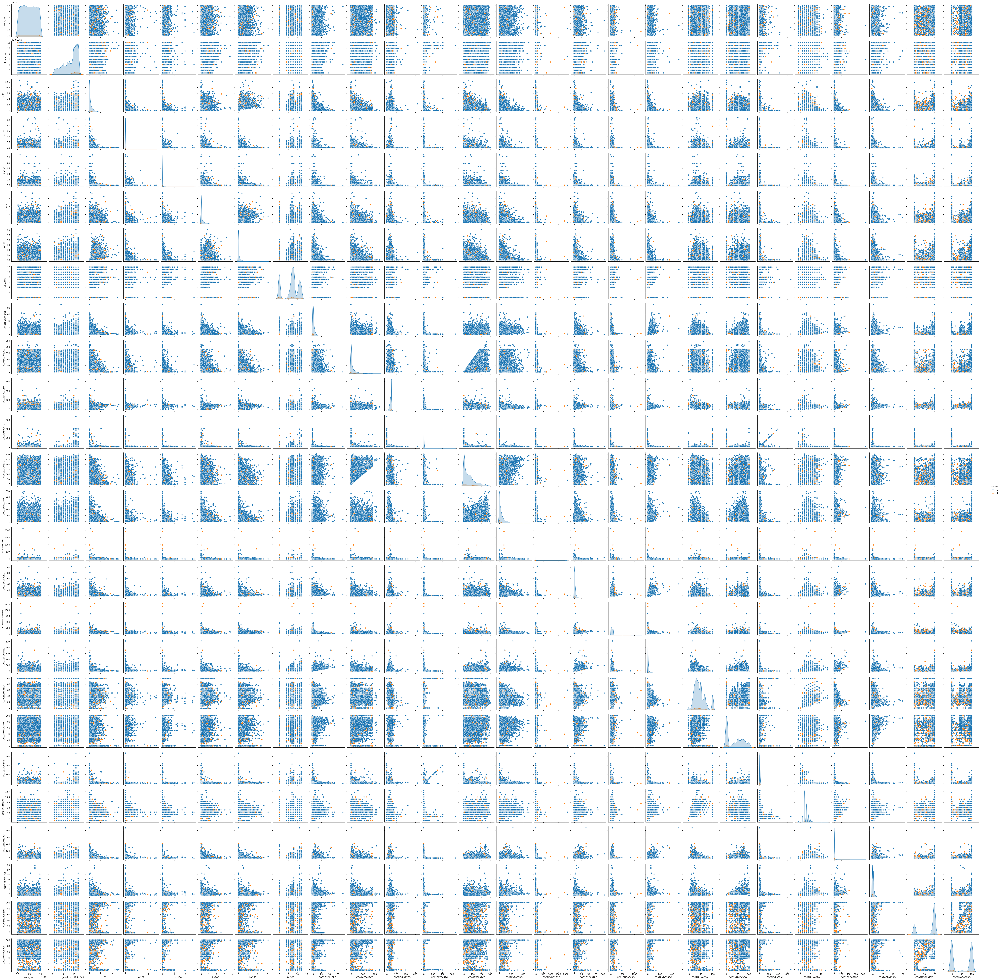

In [10]:
# grafico preliminar para entender relaciones entre variables. 
sns_plot = sns.pairplot(datos_entrenamiento,hue='default')
sns_plot

In [11]:
# Para guardar la figura. 
sns_plot.savefig('pairplot_original_toda_la_data.png')


C:\Users\Owner\AppData\Local\Temp\ipykernel_18844\2070788036.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(datos_entrenamiento.corr(), cmap="seismic", annot=True, annot_kws={"size": 8}, fmt=".1f")
C:\Users\Owner\AppData\Local\Temp\ipykernel_18844\2070788036.py:3: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show();


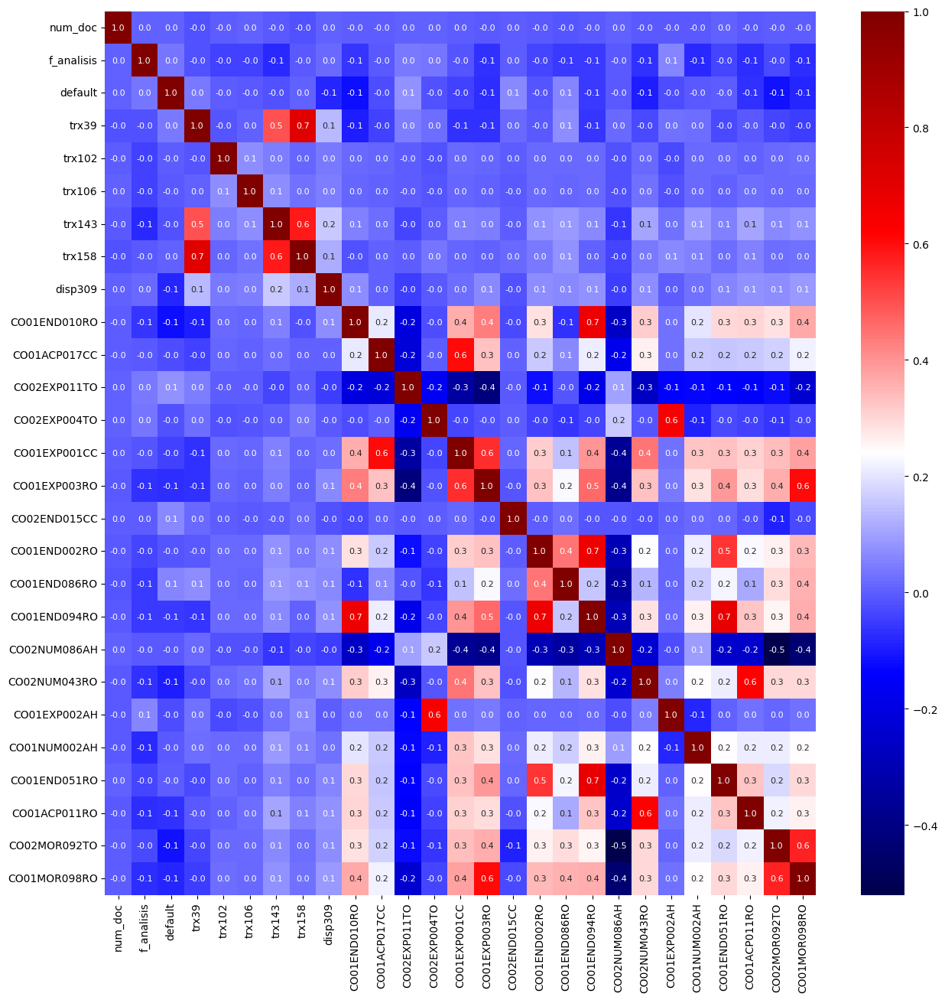

In [107]:
fig = plt.figure(figsize=(15,15))
sns.heatmap(datos_entrenamiento.corr(), cmap="seismic", annot=True, annot_kws={"size": 8}, fmt=".1f")
fig.show();

### Crear matriz de features y vector de etiquetas

In [209]:
# La columna "default" es la columna que tiene las etiquetas
# de la base de datos. 
X_train = datos_entrenamiento.drop("default", axis=1)
y_train = datos_entrenamiento["default"]

X_validacion = datos_validacion.drop("default", axis=1)
y_validacion = datos_validacion["default"]

### **Eliminar columnas**
Acá se eliminarán algunas columnas que no aportan información importante a la hora de realizar predicciones.

In [210]:
X_train = X_train.drop(["num_doc", "f_analisis"], axis=1)

In [212]:
X_validacion = X_validacion.drop(["num_doc", "f_analisis"], axis=1)

### **Codificación de la variable categórica: "*tipo_cliente*"**
El codificado es necesario porque los modelos de Machine learning funcionan mejor si solo se les entra datos numéricos, entonces se debe transformar la columna tipo_cliente en numérica.
Para realizar este codificado, es necesario usar un encoder OrdinalEncoder de sklearn

In [213]:
# Antes de hacer esto, se debe haber borrado las columnas que no se necesitan
# Seleccionar las columnas numericas
numerical_columns = [cname for cname in X_train.columns if X_train[cname].dtype in ["int64", "float64"]]

# columna categorica
categorical_columns = ["tipo_cliente"]

#### se definen los transformadores de los datos

In [215]:
numerical_transformer = MinMaxScaler()
categorical_transformer = OrdinalEncoder()

preprocessor = ColumnTransformer(
    transformers = [
        ("numerical", numerical_transformer, numerical_columns),
        ("categorical", categorical_transformer, categorical_columns)
    ]
)

In [216]:
columnas_transformadas = preprocessor.fit_transform(X_train)
# Este paso se hace para retornar los nombres de las columnas 
# al dataframe de features. ya que el preprocessor elimina estos
# nombres de columnas.
X_train = pd.DataFrame(columnas_transformadas, columns = numerical_columns + categorical_columns)

In [217]:
X_train

,trx39,trx102,trx106,trx143,trx158,disp309,CO01END010RO,CO01ACP017CC,CO02EXP011TO,CO02EXP004TO,...,CO01END094RO,CO02NUM086AH,CO02NUM043RO,CO01EXP002AH,CO01NUM002AH,CO01END051RO,CO01ACP011RO,CO02MOR092TO,CO01MOR098RO,tipo_cliente
0,0.091701,0.000000e+00,0.000000e+00,0.000000,0.079771,0.666667,0.055681,0.053498,0.137171,0.014815,...,0.013953,0.306505,0.339901,0.016320,0.214286,0.005694,0.064516,1.000000,0.000000,0.0
1,0.000000,0.000000e+00,5.042855e-07,0.000000,0.000000,0.666667,0.021498,0.008230,0.097859,0.008889,...,0.005814,0.611650,0.000000,0.007418,0.285714,0.003423,0.032258,0.029126,0.019417,0.0
2,0.072084,0.000000e+00,0.000000e+00,0.107769,0.066912,0.916667,0.227346,0.230453,0.044343,0.025185,...,0.047441,0.757282,0.910000,0.023739,0.285714,0.006276,0.048387,1.000000,1.000000,0.0
3,0.168994,3.809524e-06,9.523809e-07,0.113036,0.403882,0.666667,0.036332,0.004115,0.159021,0.002963,...,0.008488,0.306505,0.009901,0.013353,0.214286,0.000000,0.016129,0.000000,0.009709,0.0
4,0.178469,4.761905e-07,8.571429e-06,0.000000,0.129021,0.000000,0.075245,0.045267,0.133532,0.007407,...,0.069766,0.352718,0.820000,0.025223,0.214286,0.004565,0.096774,1.000000,0.895404,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28271,0.020888,0.000000e+00,0.000000e+00,0.000000,0.001404,0.583333,0.010749,0.049383,0.159021,0.005926,...,0.003876,0.352718,1.000000,0.004451,0.285714,0.010464,0.064516,1.000000,0.000000,1.0
28272,0.020888,6.666666e-06,4.761905e-06,0.000000,0.010531,1.000000,0.033000,0.008230,0.159021,0.016296,...,0.009496,0.676408,0.504950,0.014837,0.214286,0.005671,0.064516,0.000000,0.000000,0.0
28273,0.020888,0.000000e+00,0.000000e+00,0.000000,0.003510,0.666667,0.034505,0.004115,0.097859,0.004444,...,0.010232,0.417476,0.009901,0.002967,0.214286,0.005900,0.016129,1.000000,0.829199,0.0
28274,0.062665,0.000000e+00,9.523809e-07,0.017273,0.002106,0.583333,0.021498,0.004115,0.159021,0.005926,...,0.005814,0.514563,0.000000,0.004451,0.214286,0.003423,0.032258,0.000000,0.019417,0.0


In [218]:
columnas_transformadas_val = preprocessor.fit_transform(X_validacion)
X_validacion = pd.DataFrame(columnas_transformadas_val, columns = numerical_columns + categorical_columns)

In [219]:
X_validacion

,trx39,trx102,trx106,trx143,trx158,disp309,CO01END010RO,CO01ACP017CC,CO02EXP011TO,CO02EXP004TO,...,CO01END094RO,CO02NUM086AH,CO02NUM043RO,CO01EXP002AH,CO01NUM002AH,CO01END051RO,CO01ACP011RO,CO02MOR092TO,CO01MOR098RO,tipo_cliente
0,0.000000,0.000000,0.000000,0.002439,0.000000,0.666667,0.223760,0.000000,0.143731,0.009294,...,0.091298,0.320388,0.292772,0.014898,0.363636,0.067231,0.2,1.0,1.000000,0.0
1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.338235,0.016304,0.147263,0.005576,...,0.140153,0.167864,0.646436,0.029795,0.272727,0.054850,0.4,1.0,1.000000,0.0
2,0.000000,0.000000,0.000000,0.006178,0.000000,0.666667,0.105248,0.005435,0.159021,0.009294,...,0.036107,0.417476,0.009901,0.011173,0.272727,0.025661,0.0,1.0,1.000000,0.0
3,0.107557,0.400000,0.000001,0.034649,0.166131,0.666667,0.028835,0.016304,0.093486,0.009294,...,0.007634,0.167864,1.000000,0.007449,0.181818,0.035219,0.3,1.0,0.464879,0.0
4,0.028934,0.000000,0.000000,0.000000,0.005359,0.500000,0.095444,0.005435,0.159021,0.007435,...,0.025802,0.352718,0.009901,0.005587,0.181818,0.030536,0.0,0.0,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2063,0.000000,0.000000,0.000000,0.000000,0.000000,0.500000,0.130623,0.005435,0.120795,0.031599,...,0.034580,0.757282,0.009901,0.029795,0.363636,0.025661,0.0,1.0,1.000000,0.0
2064,0.000000,0.000000,0.000000,0.004878,0.000000,0.500000,0.170127,0.005435,0.159021,0.003717,...,0.052214,0.402524,0.858515,0.022346,0.545455,0.032204,0.2,1.0,1.000000,0.0
2065,0.000000,0.000000,0.000000,0.000000,0.000000,0.500000,0.000000,0.000000,0.097859,0.055762,...,0.064885,0.223301,0.009901,0.122905,0.181818,0.059982,0.0,1.0,1.000000,0.0
2066,0.067576,0.000002,0.000011,0.033019,0.084673,0.500000,0.092561,0.021739,0.159021,0.009294,...,0.032672,0.514563,0.009901,0.007449,0.363636,0.036310,0.0,1.0,0.982386,0.0


## **Entrenamiento de modelos**
Se entrenarán modelos simples de Machine Learning, puesto que acá el objetivo es obtener modelos generalistas, que disminuyan la probabilidad de sobre ajuste a los datos y además brinden facilidades a la hora de interpretar los resultados generados por los mismos. 

Por lo anterior, también se ha decidido no realizar optimización de hiperparámetros, ya que este proceso incrementa la probabilidad de sobre ajuste a los datos. 

In [220]:
lr = LogisticRegression()
knn = KNeighborsClassifier()
svm = SVC()
gnb = GaussianNB()
dt = DecisionTreeClassifier()
rf = RandomForestClassifier()

models = {
    'LogisticRegression':lr
    ,'KnnClassifier':knn
    ,'svm':svm
    ,'GaussianNB':gnb
    ,'DecisionTreeClassifier':dt
    ,'RandomForestClassifier':rf
}


In [221]:
# Diccionario que almacenará el error de cada modelo
errors = {}

for key in models.keys():

    model = models[key]
    
    # Entrenar el modelo
    model.fit(X_train, y_train)    
    predict = model.predict(X_validacion)

    # Obtener metricas para comparación
    mae = mean_absolute_error(y_validacion, predict)
    
    # saving error in dict
    errors[key] = mae

    print(100*"-")
    print(f"El error medio absoluto para el modelo {key} es: {mae}")
    

----------------------------------------------------------------------------------------------------
El error medio absoluto para el modelo LogisticRegression es: 0.07398452611218569
----------------------------------------------------------------------------------------------------
El error medio absoluto para el modelo KnnClassifier es: 0.08317214700193423
----------------------------------------------------------------------------------------------------
El error medio absoluto para el modelo svm es: 0.0725338491295938
----------------------------------------------------------------------------------------------------
El error medio absoluto para el modelo GaussianNB es: 0.1165377176015474
----------------------------------------------------------------------------------------------------
El error medio absoluto para el modelo DecisionTreeClassifier es: 0.15860735009671179
----------------------------------------------------------------------------------------------------
El error m

### **Elección del modelo** 
Pese a que el modelo LogisticRegression no fue el que mejor métrica tuvo, se decide trabajar con este, debido a su sencillez e intepretabilidad

In [159]:
model = models["LogisticRegression"]
model.fit(X_train, y_train)

LogisticRegression()

In [168]:
X_validacion.iloc[0:1]

,trx39,trx102,trx106,trx143,trx158,disp309,CO01END010RO,CO01ACP017CC,CO02EXP011TO,CO02EXP004TO,...,CO01END094RO,CO02NUM086AH,CO02NUM043RO,CO01EXP002AH,CO01NUM002AH,CO01END051RO,CO01ACP011RO,CO02MOR092TO,CO01MOR098RO,tipo_cliente
0,0.0,0.0,0.0,0.002439,0.0,0.666667,0.22376,0.0,0.143731,0.009294,...,0.091298,0.320388,0.292772,0.014898,0.363636,0.067231,0.2,1.0,1.0,0.0


In [170]:
model.predict_proba(X_validacion.iloc[0:1])

array([[0.98901063, 0.01098937]])

In [172]:
# Con éste comando podemos averiguar cuales son los respectivos 
# campos de probabilidad que da el metodo predict_proba(). por
# ejemplo, el primer valor que da predict_proba es la probabilidad
# de que el cliente cumpla sus pagos. y el segundo es la probabilidad
# de que el cliente incumpla sus pagos. 

# la categoría 1 es la que nos interesa, puesto que la tabla que contiene 
# los grupos de riesgo y sus límites de probabilidad está en base a la 
# probabilidad de incumplimiento. 
classes = model.classes_
classes

array([0, 1], dtype=int64)

In [175]:
result = pd.DataFrame(model.predict_proba(X_validacion))
result

,0,1
0,0.989011,0.010989
1,0.992714,0.007286
2,0.967877,0.032123
3,0.962498,0.037502
4,0.839100,0.160900
...,...,...
2063,0.985440,0.014560
2064,0.979902,0.020098
2065,0.840986,0.159014
2066,0.930491,0.069509


### **predicción sobre Base prueba**

In [247]:
# Llevamos a cabo el preprocesamiento de la base de datos de prueba
# para poder correr el modelo y generar las predicciones necesarias

# Leer la base de datos
ruta_prueba = "./base_prueba.csv"
prueba_data = pd.read_csv(ruta_prueba, sep = "|")

# Borrar columnas que se deben borrar
X_train_prueba = prueba_data.drop(["num_doc", "f_analisis"], axis=1)

# Aplicar preprocesado
columnas_transformadas = preprocessor.fit_transform(X_train_prueba)
# Este paso se hace para retornar los nombres de las columnas 
# al dataframe de features. ya que el preprocessor elimina estos
# nombres de columnas.
X_train_prueba = pd.DataFrame(columnas_transformadas, columns = numerical_columns + categorical_columns)

# Predicciones usando el modelo entrenado
predicciones_proba = model.predict_proba(X_train_prueba)

# convirtiendo las predicciones de probabilidades en dataframe
predicciones_proba_df = pd.DataFrame(predicciones_proba, columns = model.classes_)

# concatenar todo en la base de datos final, incluyendo los valores de probabilidad
dataset_final = pd.concat([X_train_prueba.reset_index(drop=True), predicciones_proba_df], axis=1)

# Cambiar el nombre de la columna de probabilidad para mejorar interpretación
dataset_final = dataset_final.rename(columns={1:"probabilidad_de_incumplimiento"})

### Crear la columna que contiene los grupos de riesgo de probabilidad

In [250]:
# Acá lo que se hace es convertir las salidas de probabilidad del modelo
# en los grupos categóricos de riesgo. 
rangos = [0, 0.01, 0.015, 0.03, 0.045, 0.08, 0.15, 0.3, 1]
etiquetas = ['T1', 'T2', 'T3', 'T4', 'T5', 'T6', 'T7', 'T8']
dataset_final["grupo_riesgo"] = pd.cut(dataset_final['probabilidad_de_incumplimiento'], bins=rangos, labels=etiquetas)

# Guardar el dataframe en el archivo csv pedido. 
dataset_final.to_csv('base_de_prueba_calificada.csv', sep='|', index=False)

In [251]:
dataset_final.iloc[0:10]

,trx39,trx102,trx106,trx143,trx158,disp309,CO01END010RO,CO01ACP017CC,CO02EXP011TO,CO02EXP004TO,CO01EXP001CC,CO01EXP003RO,CO02END015CC,CO01END002RO,CO01END086RO,CO01END094RO,CO02NUM086AH,CO02NUM043RO,CO01EXP002AH,CO01NUM002AH,CO01END051RO,CO01ACP011RO,CO02MOR092TO,CO01MOR098RO,tipo_cliente,0,probabilidad_de_incumplimiento,grupo_riesgo
0,0.111709,0.000000,8.500000e-06,0.040492,0.136778,0.583333,0.035057,0.180258,0.342105,0.060498,0.156463,0.002008,0.000000,0.045406,0.005401,0.018266,0.271845,0.000000,0.057554,0.181818,0.005601,0.020408,1.000000,0.019417,1.0,0.82,0.18,T7
1,0.042222,0.000000,2.000000e-06,0.000000,0.001564,0.916667,0.195267,0.064378,0.316809,0.014235,0.676871,0.144578,0.000000,0.232027,0.029850,0.230212,0.223301,0.853366,0.064748,0.363636,0.024232,0.163265,1.000000,0.900652,0.0,0.92,0.08,T5
2,0.000000,0.100000,0.000000e+00,0.000000,0.000000,0.916667,0.000000,0.008584,0.342105,0.021352,0.000000,0.034137,0.004128,0.066445,0.138428,0.024355,0.676408,0.504950,0.017986,0.272727,0.008177,0.061224,0.943631,0.000000,0.0,0.75,0.25,T7
3,0.042222,0.000000,2.000000e-06,0.000000,0.020562,0.583333,0.070990,0.008584,0.232467,0.042705,0.000000,0.024096,0.004128,0.081126,0.069889,0.039089,0.676408,0.009901,0.043165,0.272727,0.011052,0.000000,0.000000,0.000000,1.0,0.78,0.22,T7
4,0.123458,0.000000,0.000000e+00,0.053996,0.035114,0.916667,0.017528,0.004292,0.259868,0.042705,0.244898,0.000000,0.000000,0.030271,0.001800,0.012177,0.514563,1.000000,0.039568,0.272727,0.001867,0.040816,1.000000,0.000000,1.0,0.86,0.14,T6
5,0.000000,0.000000,0.000000e+00,0.007717,0.000000,0.500000,0.058370,0.004292,0.342105,0.007117,0.112245,0.038153,0.005504,0.093840,0.173949,0.039820,0.352718,0.504950,0.003597,0.454545,0.012471,0.040816,1.000000,0.000000,1.0,0.83,0.17,T7
6,0.173829,0.000021,1.950000e-05,0.230529,0.160522,0.583333,0.000000,0.034335,0.287270,0.024911,0.183673,0.046185,0.000000,0.103678,0.191862,0.041281,0.514563,0.009901,0.068345,0.363636,0.008345,0.000000,1.000000,0.972086,0.0,0.60,0.40,T8
7,0.145037,0.000000,5.000000e-07,0.110570,0.058171,1.000000,0.035057,0.274678,0.342105,0.035587,0.255102,0.002008,0.002752,0.045406,0.005401,0.018266,0.514563,0.000000,0.043165,0.181818,0.005601,0.020408,0.000000,0.019417,1.0,0.67,0.33,T8
8,0.031313,0.000000,0.000000e+00,0.002045,0.000949,0.666667,0.017528,0.004292,0.259868,0.028470,0.044218,0.000000,0.005504,0.030271,0.188226,0.012177,0.514563,1.000000,0.025180,0.272727,0.008550,0.061224,1.000000,0.843328,1.0,0.71,0.29,T7
9,0.093938,0.000000,0.000000e+00,0.000000,0.030052,0.500000,0.035057,0.103004,0.287270,0.010676,0.285714,0.002008,0.000000,0.045406,0.005401,0.018266,0.514563,0.000000,0.035971,0.363636,0.005601,0.020408,1.000000,0.019417,1.0,0.73,0.27,T7


### **Distribución por grupo de riesgo**

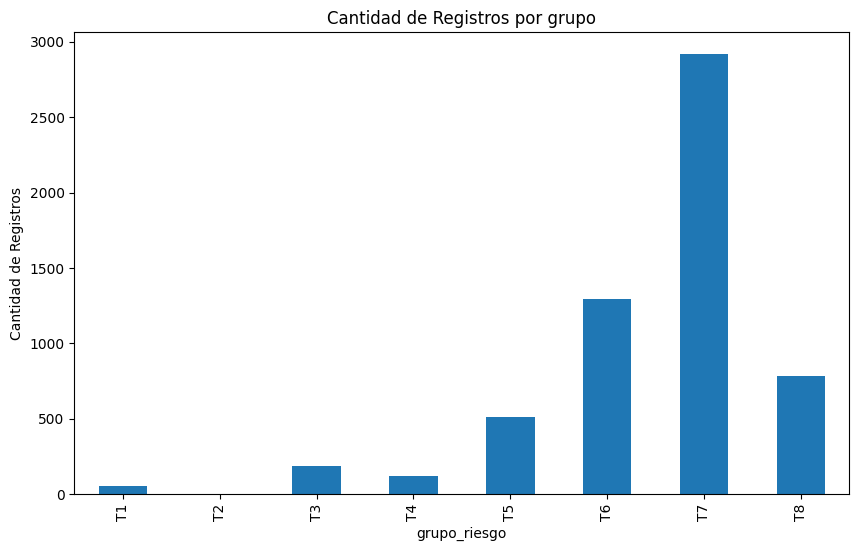

In [252]:
# Contar la cantidad de registros por cada grupo
category_counts = dataset_final['grupo_riesgo'].value_counts().sort_index()

# Crear el histograma
plt.figure(figsize=(10, 6))
category_counts.plot(kind='bar')
plt.xlabel('grupo_riesgo')
plt.ylabel('Cantidad de Registros')
plt.title('Cantidad de Registros por grupo')
plt.show()

In [258]:
# Tabla para saber cuantos hay de cada grupo
category_counts = dataset_final['grupo_riesgo'].value_counts().sort_index()
category_counts

T1      55
T2       0
T3     189
T4     120
T5     510
T6    1293
T7    2918
T8     781
Name: grupo_riesgo, dtype: int64

### Codigo que no se usará

In [194]:
# Metodo para eliminar las columnas no deseadas de nuestro
# dataframe de datos. 
class EliminarColumnas(BaseEstimator, TransformerMixin):
    def __init__(self, columns):
        self.columns = columns
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        # metodo .drop para eliminar columnas de un df.
        return X.drop(columns=self.columns)
    
eliminador = EliminarColumnas(["num_doc", "f_analisis"])
X_train = eliminador.transform(X_train)
X_train

KeyError: "['num_doc', 'f_analisis'] not found in axis"